# Clustering Collisions

__Last update: June 2022__

This notebook analyses the datasets pulled in the `dft-collision-data.ipynb` notebook. The method explored in this notebook clusters collisions to create proxies for junctions and then tries to rank these to identify the most dangerous.

The initial aim is to recreate the junctions that have already been identified by LCC as 'dangerous' to see whether we can do this automatically from data:

Current dangerous junctions map - https://lcc.org.uk/campaigns/dangerous-junctions/

__IDEAs:__
- What happens if two cyclists seriously injured at junction, does that count twice?
- Can we add a recency bias to the junction weighting

In [125]:
import os
import geopandas
import numpy as np
import pandas as pd
import networkx as nx
import contextily as cx
import seaborn as sns
import matplotlib.pyplot as plt

from scipy import spatial
from dotenv import load_dotenv
from ipyleaflet import Map, MarkerCluster, basemaps, Marker
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN, AgglomerativeClustering

load_dotenv()
os_api_key = os.getenv('OS_API_KEY')

%config InlineBackend.figure_format = 'retina'

sns.set_palette('Dark2')
plt.rcParams["font.family"] = "Calibri"
plt.rcParams["font.size"] = 12

In [109]:
def weight_accident_severity(severity):
    '''
    Upweights more severe collisions for junction comparison.
    '''
    if severity == 'Fatal':
        return 3
    if severity == 'Serious':
        return 1
    else:
        return 0
    
    
def is_serious(severity):
    '''
    Tag serious collisions
    '''
    if severity == 'Serious':
        return 1
    else:
        return 0
    
    
def is_fatal(severity):
    '''
    Tag fatal collisions
    '''
    if severity == 'Fatal':
        return 1
    else:
        return 0
    
    
def get_nearest_junction(row, tree):
    coordinate = row[['latitude', 'longitude']].values
    result = tree.query(coordinate)

    distance = result[0]
    junction_id = result[1]
    return distance, junction_id

# 1. Read in data

View sample of random collision for reference.

In [3]:
# not a massive fan of the use of the term 'accidents'
collisions = pd.read_csv('../data/london-crashes.csv')

collisions.rename(columns={'accident_index': 'id'}, inplace=True)

# example row
collisions.sample(1).T

,163
id,200001CP00378
accident_year,2000
accident_reference,01CP00378
location_easting_osgr,531600.0
location_northing_osgr,181360.0
longitude,-0.104787
latitude,51.515788
police_force,City of London
accident_severity,Slight
number_of_vehicles,2


# 1. Filter and split data

Remove 'Private drive or entrance' junction types for now and split out data into two dataframes:
1. `slight` - slight collisions'
2. `serious_or_slight` - serious or fatal

__Note:__ important to use the calculated `max_cyclist_severity` field for this.

In [4]:
print(collisions.accident_severity.unique())
print(collisions.junction_detail.unique())

['Slight' 'Serious' 'Fatal']
['T or staggered junction' 'Crossroads' 'Other junction'
 'More than 4 arms (not roundabout)' 'Private drive or entrance'
 'Roundabout' 'Slip road' 'Mini-roundabout']


In [23]:
junction_collisions = collisions[
    # (collisions['accident_severity'] != 'Slight') &
    (collisions['junction_detail'] != 'Private drive or entrance')
]

slight = junction_collisions[junction_collisions['max_cyclist_severity'] == 'Slight'].copy()
serious_or_fatal = junction_collisions[junction_collisions['max_cyclist_severity'] != 'Slight'].copy()

junction_collisions.head()

,id,accident_year,accident_reference,location_easting_osgr,location_northing_osgr,longitude,latitude,police_force,accident_severity,number_of_vehicles,...,weather_conditions,road_surface_conditions,special_conditions_at_site,carriageway_hazards,urban_or_rural_area,did_police_officer_attend_scene_of_accident,trunk_road_flag,lsoa_of_accident_location,datetime,max_cyclist_severity
0,200001BS00005,2000,01BS00005,526300.0,178910.0,-0.182005,51.494979,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002835,2000-01-02T14:00:00Z,Slight
1,200001BS00010,2000,01BS00010,525660.0,179660.0,-0.190953,51.501862,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002826,2000-01-06T19:43:00Z,Slight
2,200001BS00019,2000,01BS00019,523970.0,179950.0,-0.215187,51.504841,Metropolitan Police,Slight,2,...,Fine no high winds,Dry,None,None,Urban,Yes,Non-trunk,E01002869,2000-01-11T15:30:00Z,Slight
3,200001BS00024,2000,01BS00024,527100.0,178000.0,-0.170814,51.486622,Metropolitan Police,Serious,2,...,Raining no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002844,2000-01-13T08:00:00Z,Serious
4,200001BS00036,2000,01BS00036,527940.0,178900.0,-0.158397,51.494521,Metropolitan Police,Serious,2,...,Fine no high winds,Wet or damp,None,None,Urban,Yes,Non-trunk,E01002859,2000-01-19T05:50:00Z,Serious


# 3. Plot all collisions

Will add map later. With this many collisions it's difficult to read with a map overlay, plus it's possible to make out the roads anyways.

Can already see it will probably difficult finding a clustering algorithm that works on the differing regions of density, since central London is much more dense in points, but we still want junction clusters to be found outside of central London.

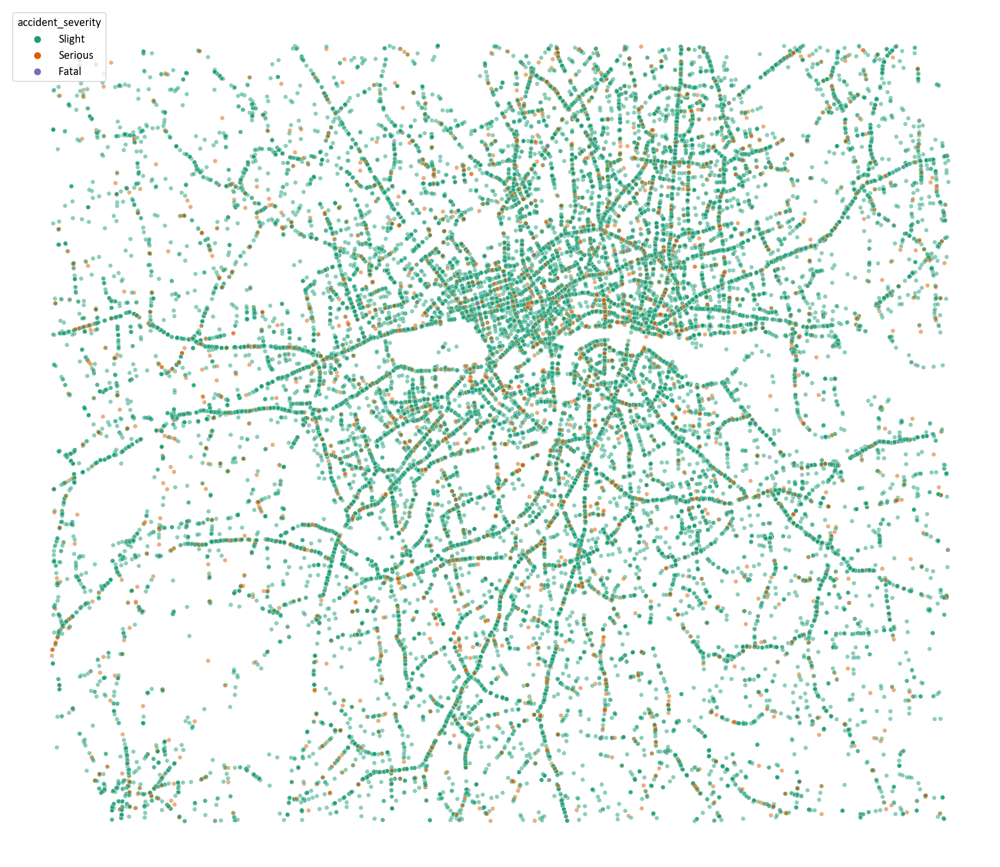

In [6]:
fig, ax = plt.subplots(figsize=(18, 16))
sns.scatterplot(
    data=junction_collisions,
    x='longitude',
    y='latitude',
    hue='accident_severity',
    alpha=.5,
    s=20
);

ax.set_axis_off()

# 4. Convert to Geo Pandas DF

This will allow us to plot maps underneath data etc.

## 4.1 Plot all collisions

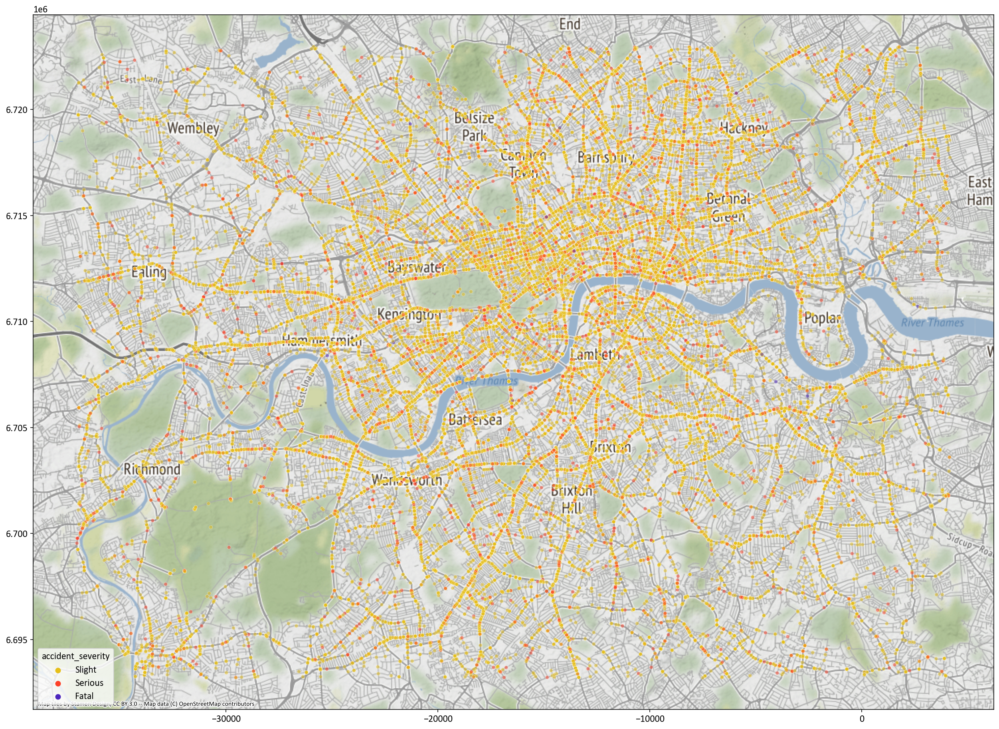

In [17]:
gpd_junction_collisions = geopandas.GeoDataFrame(
    junction_collisions,
    geometry=geopandas.points_from_xy(junction_collisions.longitude, junction_collisions.latitude, crs="EPSG:4326")
)

gpd_junction_collisions.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(24, 16))

sns.scatterplot(
    x=gpd_junction_collisions.geometry.x,
    y=gpd_junction_collisions.geometry.y,
    hue=gpd_junction_collisions.accident_severity,
    alpha=.5,
    s=20,
    palette=sns.color_palette('CMRmap_r', 3)
);

cx.add_basemap(ax)

## 4.2 Plot just serious or fatal collisions

Not the easiest to read!

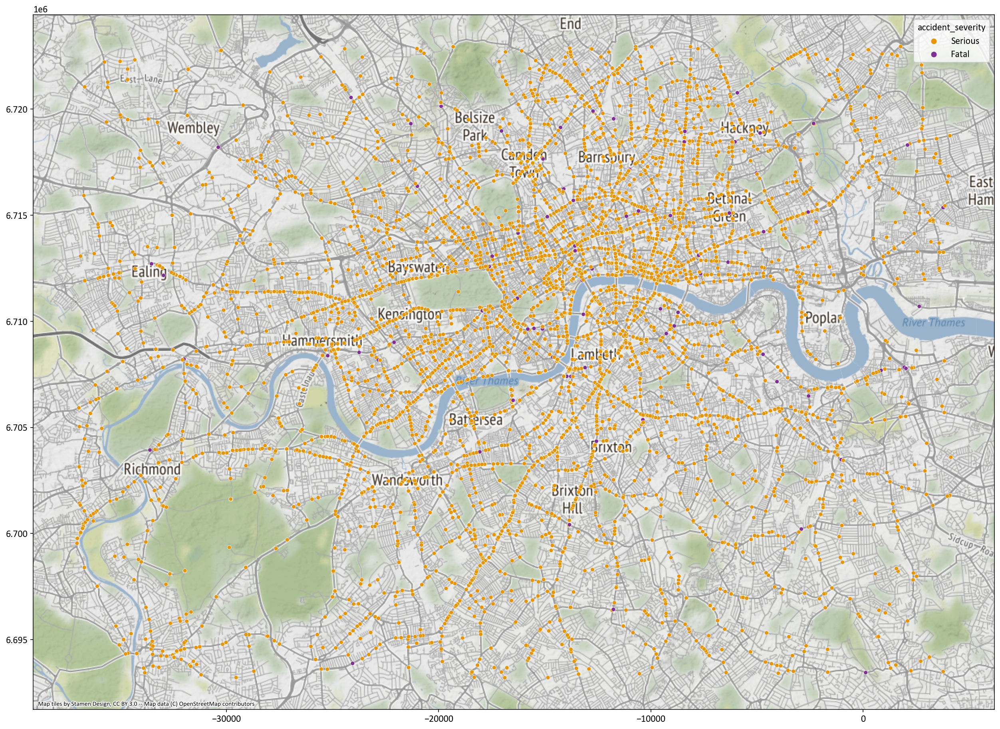

In [79]:
fig, ax = plt.subplots(figsize=(24, 16))

plt_data = gpd_junction_collisions[
    gpd_junction_collisions.accident_severity != 'Slight'
]

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.accident_severity,
    alpha=1,
    s=25,
    palette=sns.color_palette('CMRmap_r', 2)
);

cx.add_basemap(ax)
del plt_data

# 5. Clustering

Clustering just serious or fatal since there are likely too many points otherwise.

Can we cluster points to identify junctions and then allow us to filter to high collision junctions?

Best params so far:
- `eps=.03`
- `min_samples=3`

In [96]:
scaler = StandardScaler()

X = serious_or_fatal[['longitude', 'latitude']]
X = scaler.fit_transform(X)

clustering = DBSCAN(eps=.03, min_samples=3).fit(X)
# clustering = AgglomerativeClustering(n_clusters=1500).fit(X)

serious_or_fatal['cluster'] = clustering.labels_.astype(str)

print(f'Found {len(set(clustering.labels_)) - 1} clusters (includes 1 outlier cluster)')

serious_or_fatal['collision_metric'] = serious_or_fatal['accident_severity'].apply(weight_accident_severity)
serious_or_fatal['n_serious'] = serious_or_fatal['accident_severity'].apply(is_serious)
serious_or_fatal['n_fatal'] = serious_or_fatal['accident_severity'].apply(is_fatal)

junctions = (
    serious_or_fatal[serious_or_fatal['cluster'] != '-1']  # filter out 'outlier' cluster
    .groupby('cluster')
    .agg({
        'latitude': 'mean',
        'longitude': 'mean',
        'collision_metric': 'sum',
        'n_serious': 'sum',
        'n_fatal': 'sum'})
    .reset_index()
    .reset_index()
)

# TODO: see if we can add in sllight collisions so this works.
# junctions['serious_slight_ratio'] = junctions['is_serious_or_fatal'] / junctions['is_slight']

junctions['danger_rank'] = junctions['collision_metric'].rank(ascending=False)
junctions.sort_values(by='danger_rank', inplace=True)

gpd_junctions = geopandas.GeoDataFrame(
    junctions,
    geometry=geopandas.points_from_xy(junctions.longitude, junctions.latitude, crs="EPSG:4326")
)
gpd_junctions.to_crs(epsg=3857, inplace=True)

junctions.head(10)

Found 610 clusters (includes 1 outlier cluster)


,index,cluster,latitude,longitude,collision_metric,n_serious,n_fatal,danger_rank,geometry
224,224,30,51.520412,-0.113629,134,110,8,1.0,POINT (-12649.112 6713870.050)
13,13,11,51.511722,-0.089796,109,97,4,2.0,POINT (-9996.001 6712315.548)
46,46,14,51.514040,-0.104212,91,82,3,3.0,POINT (-11600.827 6712730.223)
556,556,6,51.505712,-0.219658,70,70,0,4.0,POINT (-24452.264 6711240.514)
24,24,12,51.518442,-0.085458,57,48,3,5.0,POINT (-9513.117 6713517.539)
579,579,71,51.493327,-0.100966,55,49,2,6.0,POINT (-11239.508 6709025.914)
568,568,61,51.482009,-0.112286,54,45,3,7.0,POINT (-12499.593 6707002.549)
79,79,17,51.516081,-0.137507,46,43,1,8.0,POINT (-15307.232 6713095.151)
346,346,41,51.471540,-0.204010,45,45,0,9.0,POINT (-22710.277 6705131.401)
588,588,8,51.486431,-0.180200,38,29,3,10.0,POINT (-20059.758 6707793.072)


## 5.1 - Plot Clusters

See if the generated cluster look sensible. Ideally don't want too many overlapping or very close together.

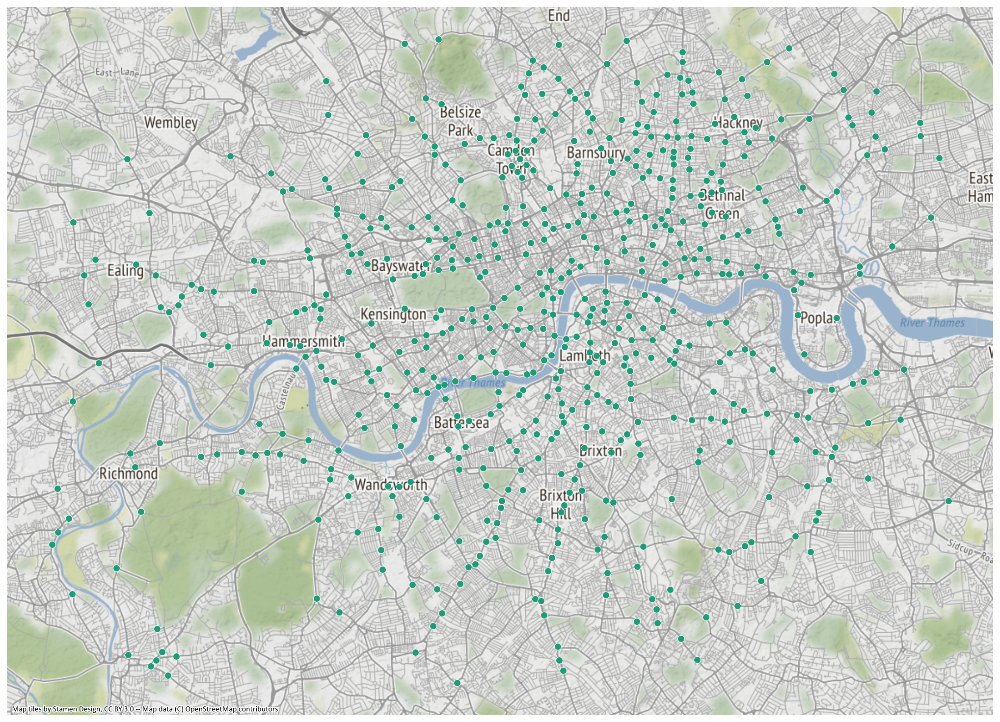

In [91]:
fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions[gpd_junctions['cluster'] != '-1']

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    s=50,
    legend=False
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

## 5.1 - Plot most severe clusters

Ranked by collision metric, where:
- Fatal - counts as a 3
- Serious - counts as a 1

Plot 'top n'. `n=80` for now.

At least by eye this looks pretty good. Most of the already manually identified junctions are here, plus a bunch more...

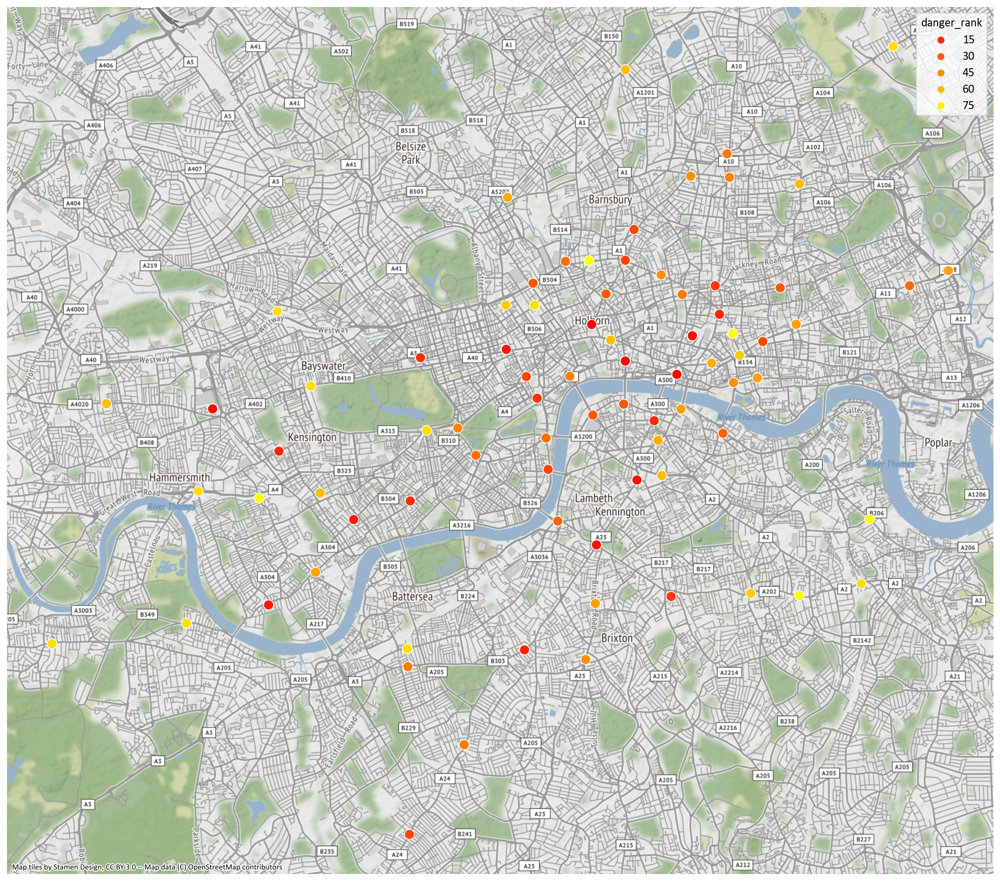

In [107]:
fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions.head(80)

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.danger_rank,
    palette='autumn',
    alpha=1,
    s=100,
    legend=True
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

# 6. Add in slight collisions

Kept these separate before to prevent messing with clustering, but now can add them.

To add them in we'll find their nearest junction and check if it's within certain threshold.

__ISSUE:__ Some junctions may 'mop' up collisions, so not sure it works to scale by n_slight...

In [123]:
tree = spatial.KDTree(junctions[['latitude', 'longitude']])

slight[['distance', 'index']] = slight.apply(
    lambda row: get_nearest_junction(row, tree), axis=1, result_type='expand'
)

slight_counts = slight[slight['distance'] < .01].groupby('index')['id'].count().reset_index(name='n_slight')

junctions_plus_slight = junctions.merge(slight_counts, how='left', on='index')

junctions_plus_slight['scaled_collision_metric'] = (
    junctions_plus_slight['collision_metric'] / junctions_plus_slight['n_slight']
)
junctions_plus_slight.sort_values(by='scaled_collision_metric', ascending=False).head(20)

,index,cluster,latitude,longitude,collision_metric,n_serious,n_fatal,danger_rank,geometry,n_slight,scaled_collision_metric
6,568,61,51.482009,-0.112286,54,45,3,7.0,POINT (-12499.593 6707002.549),9,6.000000
3,556,6,51.505712,-0.219658,70,70,0,4.0,POINT (-24452.264 6711240.514),19,3.684211
40,479,53,51.546034,-0.075070,20,17,1,42.0,POINT (-8356.773 6718455.120),10,2.000000
52,335,40,51.477252,-0.190887,18,18,0,50.5,POINT (-21249.499 6706152.249),11,1.636364
20,512,56,51.517441,-0.065748,26,20,2,22.5,POINT (-7319.044 6713338.438),19,1.368421
358,253,326,51.492311,-0.121527,4,4,0,380.0,POINT (-13528.379 6708844.190),3,1.333333
0,224,30,51.520412,-0.113629,134,110,8,1.0,POINT (-12649.112 6713870.050),102,1.313725
1,13,11,51.511722,-0.089796,109,97,4,2.0,POINT (-9996.001 6712315.548),84,1.297619
29,534,58,51.526801,-0.060899,24,18,2,28.0,POINT (-6779.251 6715013.181),19,1.263158
26,594,85,51.525725,-0.109618,24,24,0,28.0,POINT (-12202.657 6714820.667),20,1.200000


## Plot most dangerour 'scaled' junctions

Scaling too agressive currently.

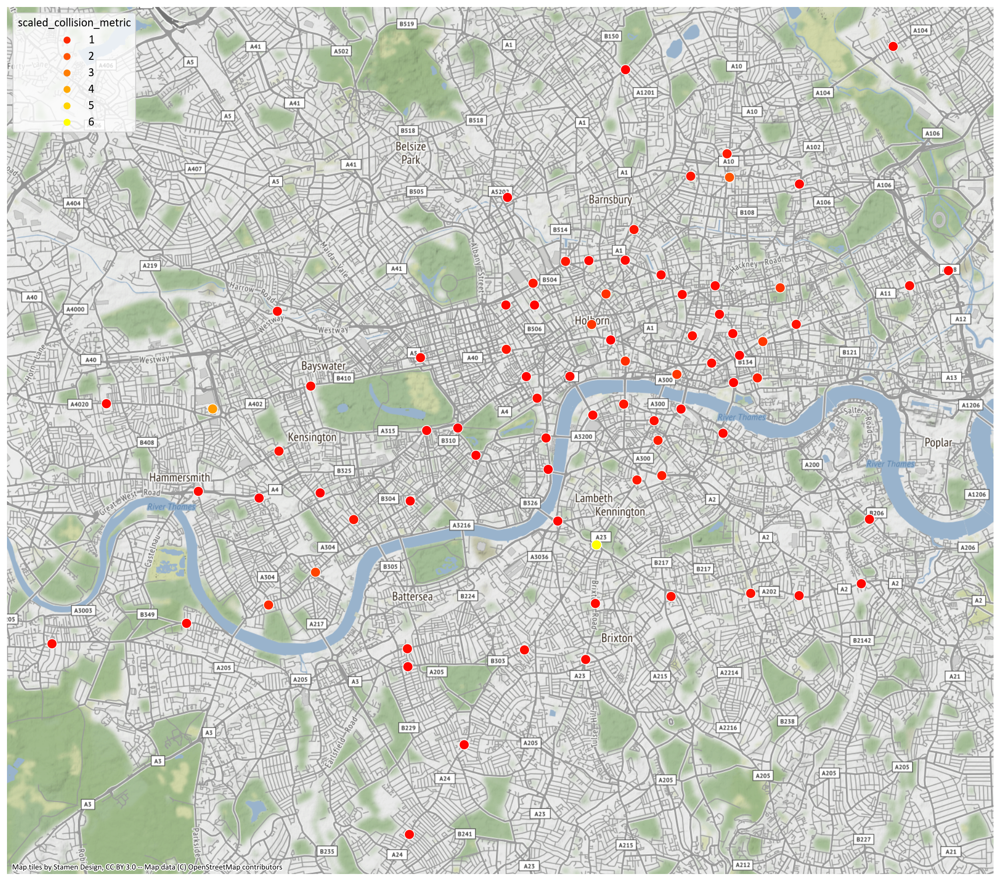

In [124]:
gpd_junctions_plus_slight = geopandas.GeoDataFrame(
    junctions_plus_slight,
    geometry=geopandas.points_from_xy(junctions_plus_slight.longitude, junctions_plus_slight.latitude, crs="EPSG:4326")
)
gpd_junctions_plus_slight.to_crs(epsg=3857, inplace=True)

fig, ax = plt.subplots(figsize=(18, 16))

plt_data = gpd_junctions_plus_slight.head(80)

sns.scatterplot(
    x=plt_data.geometry.x,
    y=plt_data.geometry.y,
    hue=plt_data.scaled_collision_metric,
    palette='autumn',
    alpha=1,
    s=100,
    legend=True
);

cx.add_basemap(ax)

ax.set_axis_off()
del plt_data

# 7. Plot above junctions (from 5.) with leaflet

Interactivity for zooming in & out.

In [130]:
m = Map(
    center=(51.486622, -0.170814),
    zoom=11,
    # basemap=basemaps.Strava.Ride
    basemap=basemaps.CartoDB.Positron
)

clusters_to_plot = junctions.sort_values(by='danger_rank').head(80).cluster

for lon, lat in junctions[junctions['cluster'].isin(clusters_to_plot)][["longitude", "latitude"]].values:
    marker = Marker(location=(lat, lon), draggable=False, name='hi')
    m.add_layer(marker)
    
m.layout.height="600px"

m

Map(center=[51.486622, -0.170814], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title',…